In [1]:
%pylab inline
from scipy.integrate import solve_ivp
from IPython import display
import time
import scipy.integrate as integrate
from scipy.optimize import curve_fit
import seaborn as sb

Populating the interactive namespace from numpy and matplotlib


### Initializations

In [6]:
# the 1D space
length = 30.0
Lmax = length
Lmin = -length
dx = 0.1
Nx = int((Lmax-Lmin)/dx) +1
xs = linspace(Lmin, Lmax, Nx)

# will be used to determine atot (atot = N) when only D is specified  
# and used to determine D (D = atot/N) when only atot is specified
nu = 1.0

# the diffusion coefficients
Ds = logspace(-3,-1,21,base=10)
D_n = len(Ds)

Ns = logspace(1,3,21,base = 10)
N_n = len(Ns)

dt = 0.001
tf = 100.0 #each run goes for (tf/dt) steps 
run_n = 30 # number of runs

print(Ns,Ds)

[  10.           12.58925412   15.84893192   19.95262315   25.11886432
   31.6227766    39.81071706   50.11872336   63.09573445   79.43282347
  100.          125.89254118  158.48931925  199.5262315   251.18864315
  316.22776602  398.10717055  501.18723363  630.95734448  794.32823472
 1000.        ] [0.001      0.00125893 0.00158489 0.00199526 0.00251189 0.00316228
 0.00398107 0.00501187 0.00630957 0.00794328 0.01       0.01258925
 0.01584893 0.01995262 0.02511886 0.03162278 0.03981072 0.05011872
 0.06309573 0.07943282 0.1       ]


### Biased initial substrate 
#### efficiency vs. D (a0 = 1/sigma)

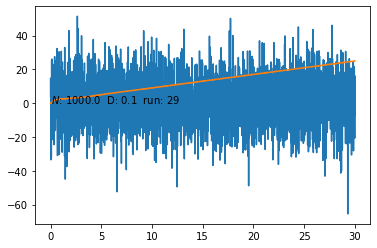

In [7]:
sol_0Db = []
for N in Ns:
    sol_1 = []
    for D in Ds: 
        sol_2 = []
        for run in range(run_n):
            xp = 0.0
            Ac = zeros(Nx) #initialize bound complex

            #intialize substrate
            As = zeros(Nx) 
            As[xs > 0.0] = linspace(0.1,length,int(Lmax/dx)) * N/2.0 # create initial gradient with slope (a0/2.0)
            As[xs > 2.0] = N # biased to the right

            # some values to save for each time step
            xp_t = [] # position
            v_t = [] # times
            burn_t = [] # burn rate

            noisescale = sqrt(2*dt*D) # the scale of diffusion
            t_max = int(tf/dt)
            for t in range(t_max): 

                total_f = D * trapz(-(xp -xs) * Ac, x=xs)
                binding = exp(-0.5 * (xp - xs) ** 2) * As
                burnt = nu * Ac
                Ac += (binding - burnt) *dt
                As += (- binding) * dt
                noise = noisescale* random.normal(0.0,1.0)

                xp += total_f * dt + noise # update position

                if t % 10.0 == 0.0: # save values
                    xp_t.append(xp)
                    v_t.append(total_f+noise/dt)
                    burn_t.append(trapz(Ac*nu,x=xs))

                if abs(xp) > length -5.0: # stop before it hits an edge
                    break

            # see the velocity and position for the run        
            display.clear_output(wait=True)
            cla()
            plot(linspace(0,int((t+1)*dt),int(t/10+1)),v_t)
            plot(linspace(0,int((t+1)*dt),int(t/10+1)),xp_t)
            text(0.0,0.0,r"$N$: " +str(round(N,2))+"  D: "+str(round(D,4))+"  run: " +str(run))
            display.display(gcf())

            # save the mean velocity and burn rate for the run
            start_index = 2000
            sol_2.append([xp_t[-start_index:],burn_t[-start_index:]])
        # save these for each diffusion coefficient
        sol_1.append(sol_2)
    sol_0Db.append(sol_1)
display.clear_output(wait=True)

### Efficiency with quadratic fit

In [17]:
def quadratic(x,a,b,c):
    return a*x**2 + b*x + c

effsq0 = []
vsq0 = []
for i in range(N_n):
    effsq1 = []
    vsq1 = []
    for j in range(D_n): # diffusion coefficients
        print(Ns[i],Ds[j])
        tmax = len(sol_0Db[i][j][0][0])
        taumax = tmax/5
        taus = array(range(10,int(taumax),int((taumax-10)/20)))
        
        burn_aves = []
        for k in range(run_n):
            burn_aves.append(mean(array(sol_0Db[i][j][k][1]),axis=0))
        x2_tau = []
        for n in taus:
            x2 = [] 
            for l in range(run_n):
                xps = array(sol_0Db[i][j][l][0])
                x2.extend(diff(xps[::(n+1)])**2)
            x2_tau.append(mean(x2))
        x = taus*10*dt
        y = x2_tau
        popt,pcov = curve_fit(quadratic,x,y,p0=[1,1,1])

        eff = 1/Ds[j]*popt[0]/mean(burn_aves)
        effsq1.append(eff)
        vsq1.append(sqrt(abs(popt[0])))
    effsq0.append(effsq1)
    vsq0.append(vsq1)
effsq0 = array(effsq0)
vsq0 = array(vsq0)

    

10.0 0.001
10.0 0.0012589254117941675
10.0 0.001584893192461114
10.0 0.001995262314968879
10.0 0.0025118864315095794
10.0 0.0031622776601683794
10.0 0.003981071705534973
10.0 0.005011872336272725
10.0 0.00630957344480193
10.0 0.007943282347242814
10.0 0.01
10.0 0.012589254117941675
10.0 0.01584893192461114
10.0 0.0199526231496888
10.0 0.025118864315095808
10.0 0.03162277660168379
10.0 0.039810717055349734
10.0 0.05011872336272725
10.0 0.06309573444801933
10.0 0.07943282347242818
10.0 0.1
12.589254117941675 0.001
12.589254117941675 0.0012589254117941675
12.589254117941675 0.001584893192461114
12.589254117941675 0.001995262314968879
12.589254117941675 0.0025118864315095794
12.589254117941675 0.0031622776601683794
12.589254117941675 0.003981071705534973
12.589254117941675 0.005011872336272725
12.589254117941675 0.00630957344480193
12.589254117941675 0.007943282347242814
12.589254117941675 0.01
12.589254117941675 0.012589254117941675
12.589254117941675 0.01584893192461114
12.58925411794167

125.89254117941675 0.005011872336272725
125.89254117941675 0.00630957344480193
125.89254117941675 0.007943282347242814
125.89254117941675 0.01
125.89254117941675 0.012589254117941675
125.89254117941675 0.01584893192461114
125.89254117941675 0.0199526231496888
125.89254117941675 0.025118864315095808
125.89254117941675 0.03162277660168379
125.89254117941675 0.039810717055349734
125.89254117941675 0.05011872336272725
125.89254117941675 0.06309573444801933
125.89254117941675 0.07943282347242818
125.89254117941675 0.1
158.48931924611142 0.001
158.48931924611142 0.0012589254117941675
158.48931924611142 0.001584893192461114
158.48931924611142 0.001995262314968879
158.48931924611142 0.0025118864315095794
158.48931924611142 0.0031622776601683794
158.48931924611142 0.003981071705534973
158.48931924611142 0.005011872336272725
158.48931924611142 0.00630957344480193
158.48931924611142 0.007943282347242814
158.48931924611142 0.01
158.48931924611142 0.012589254117941675
158.48931924611142 0.015848931

### efficiency with histogram fit

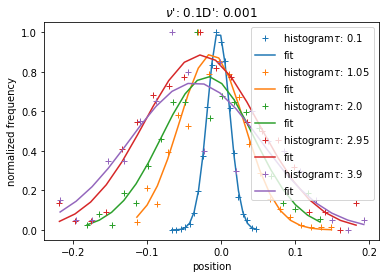

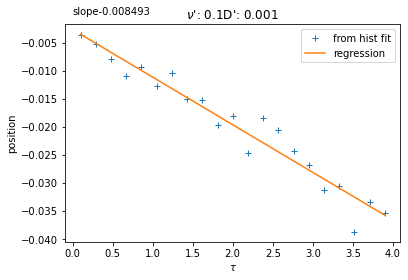

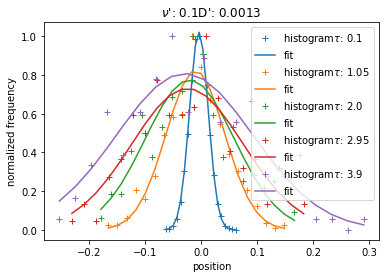

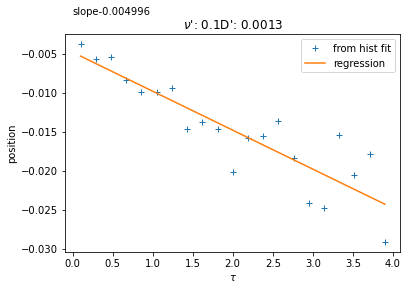

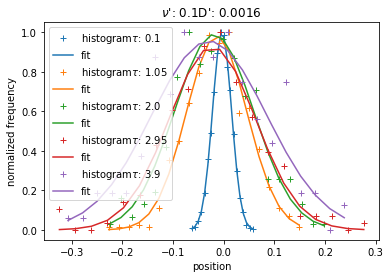

...

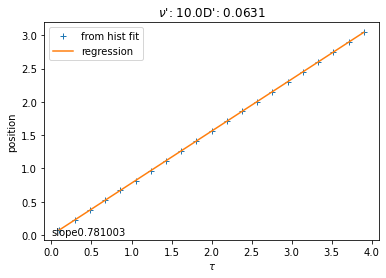

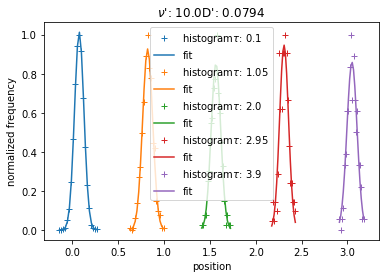

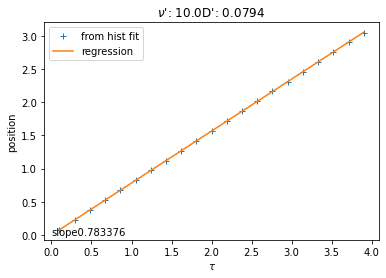

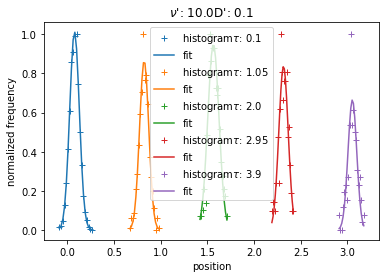

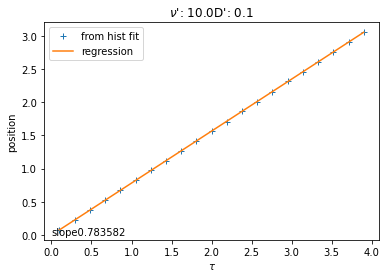

In [18]:
#fig, axs = plt.subplots(2,D_n,sharey="row",figsize = (16,15))
effsh0 = []
vsh0 = []
for i in range(N_n):
    effsh1 = []
    vsh1 = []
    for j in range(D_n): 
        burn_aves = []
        for k in range(run_n): 
            burn_aves.append(mean(array(sol_0Db[i][j][k][1]),axis=0))
        tmax = len(sol_0Db[i][j][0][0])
        taumax = tmax/5
        taus = array(range(10,int(taumax),int((taumax-10)/20)))
        delta_xs_tau = [] # save the dxs for each tau
        for n in taus:
            delta_xs = [] # save the dxs for all runs
            for l in range(run_n):
                xps = array(sol_0Db[i][j][l][0])
                delta_xs.extend(diff(xps[::(n+1)]))
            delta_xs_tau.append(delta_xs)

        def gaus(x,a,ave,sigma):
            return a*numpy.exp(-(x-ave)**2/(2*sigma**2))

        def linear(x,m,b):
            return m*x + b
        colors = ["tab:blue", "tab:orange","tab:green","tab:red","tab:purple"]
        c= 0
        deltaX = []
        for l in range(len(delta_xs_tau)):
            x = histogram(delta_xs_tau[l],bins = 20)[1][:-1]
            y = histogram(delta_xs_tau[l],bins = 20)[0]

            a = max(y)
            ave = mean(x)
            sigma = mean((x-ave)**2)

            popt,pcov = curve_fit(gaus,x,y,p0=[a,ave,sigma])

            if l % 5 == 0:
                normalizer = max(y)
                plot(x,y/normalizer,"+",label = "histogram"+ r"$\tau$: " +str(round(taus[l]*dt*10,4)),color = colors[c])
                plot(x,gaus(x,*popt)/normalizer, label = "fit",color = colors[c])
                title(r"$\nu$': "+ str(round(nus[i],4))+"D': "+ str(round(Ds[j],4)))
                ylabel("normalized frequency")
                xlabel("position")
                legend()
                c+=1
            aveX = popt[1]
            deltaX.append(aveX)
        show()
        tausT = array(taus)*10*dt
        poplin,plin = curve_fit(linear,tausT, deltaX, p0 = [1.0,0.0])
        plot(tausT,deltaX,"+",label = "from hist fit")
        plot(tausT, linear(tausT,*poplin),label = "regression")
        text(0,0, "slope"+str(round(poplin[0],6)) )
        ylabel("position")
        xlabel(r"$\tau$")
        title(r"$\nu$': "+ str(round(nus[i],4))+"D': "+ str(round(Ds[j],4)))
        legend()
        show()
        effsh1.append(1/Ds[j]*poplin[0]**2/mean(burn_aves))
        vsh1.append(poplin[0])
    effsh0.append(effsh1)
    vsh0.append(vsh1)


Text(0.5, 1.0, 'Quadratic fit')

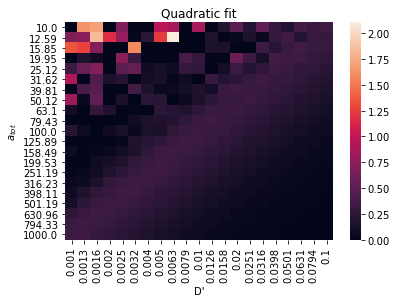

In [21]:
Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],4)
nustmp = zeros(N_n)
for i in range(N_n):
    nustmp[i] = round(Ns[i],2)
for i in range(N_n):
    for j in range(D_n):
        if effsq0[i][j] < 0.0:
            effsq0[i][j] = 0.0
sb.heatmap(effsq0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$a_{tot}$")
xlabel("D'")
title("Quadratic fit")

Text(0.5, 1.0, 'Quadratic fit')

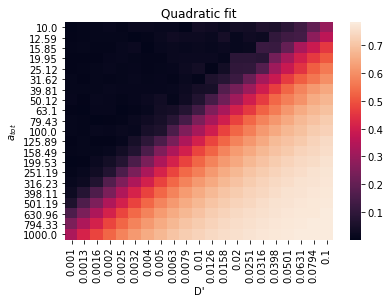

In [24]:
Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],4)
nustmp = zeros(N_n)
for i in range(N_n):
    nustmp[i] = round(Ns[i],2)
for i in range(N_n):
    for j in range(D_n):
        if vsq0[i][j] < 0.0:
            vsq0[i][j] = 0.0
sb.heatmap(vsq0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$a_{tot}$")
xlabel("D'")
title("Quadratic fit")

(21, 21) (21,) (21,)


Text(0.5, 1.0, 'Histogram fit')

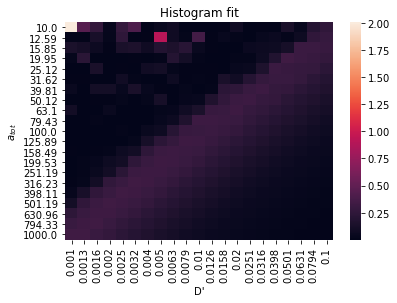

In [22]:
effsh0 = array(effsh0)
Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],4)
nustmp = zeros(nu_n)
for i in range(N_n):
    nustmp[i] = round(Ns[i],2)
print(effsh0.shape,nustmp.shape,Dstmp.shape)
sb.heatmap(effsh0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$a_{tot}$")
xlabel("D'")
title("Histogram fit")

Text(0.5, 1.0, 'Histogram fit')

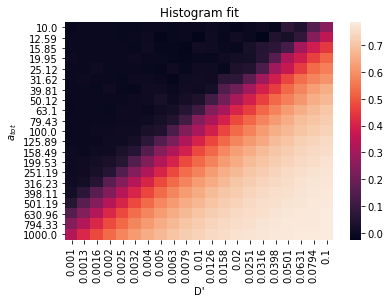

In [26]:
Dstmp = zeros(D_n)
for i in range(D_n):
    Dstmp[i] = round(Ds[i],4)
nustmp = zeros(N_n)
for i in range(N_n):
    nustmp[i] = round(Ns[i],2)
sb.heatmap(vsh0, xticklabels = Dstmp, yticklabels = nustmp)
ylabel(r"$a_{tot}$")
xlabel("D'")
title("Histogram fit")

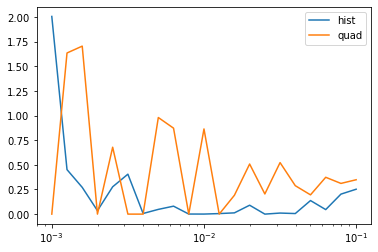

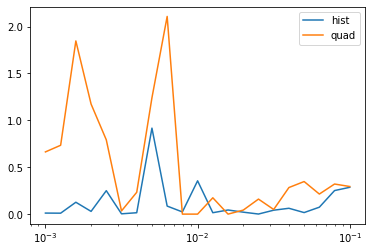

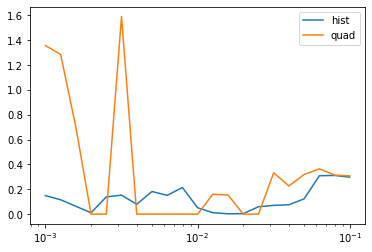

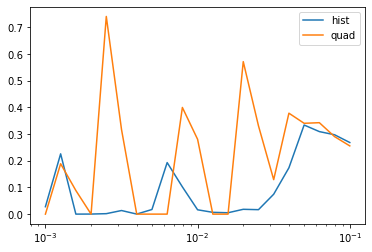

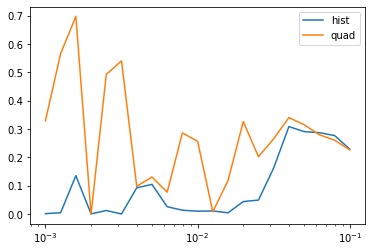

...

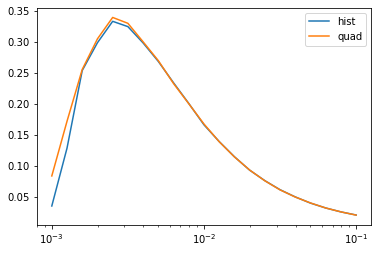

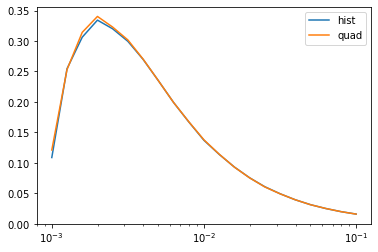

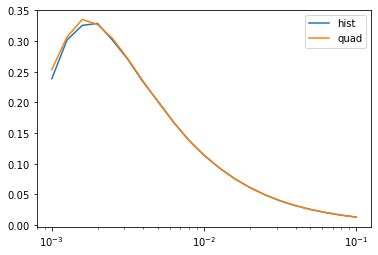

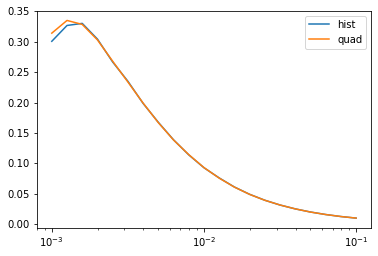

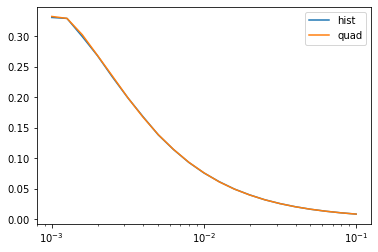

In [12]:
for i in range(N_n):
    plot(Ds,effsh0[i], label = "hist")
    plot(Ds,effsq0[i], label = "quad")
    xscale('log')
    #yscale("log")
    legend()
    show()

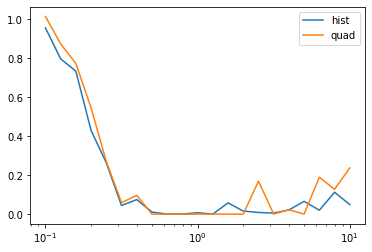

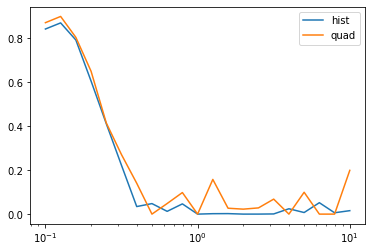

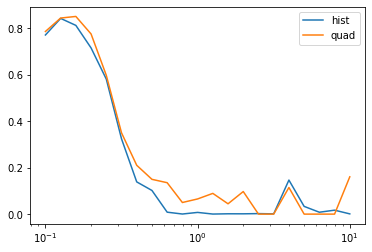

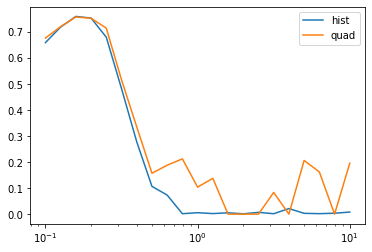

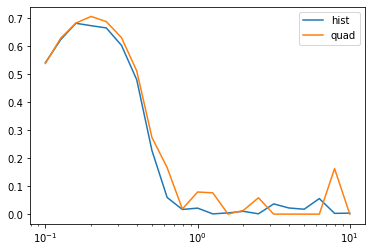

...

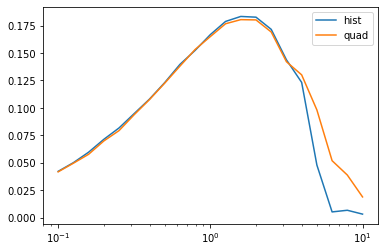

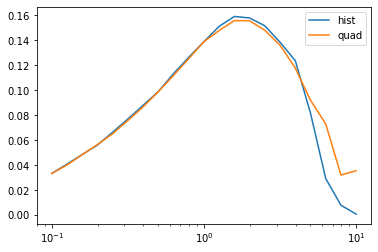

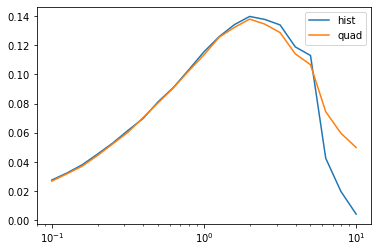

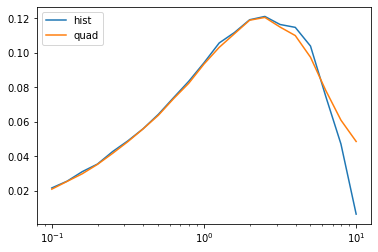

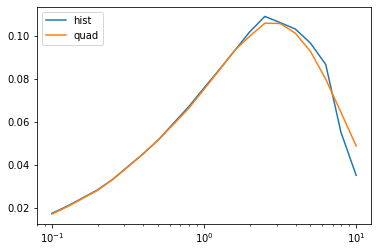

In [117]:
for i in range(D_n):
    plot(nus,effsh0[:,i], label = "hist")
    plot(nus,effsq0[:,i], label = "quad")
    xscale('log')
    #yscale("log")
    legend()
    show()